In [1]:
using Flux, Statistics
using Flux: onehotbatch, onecold, crossentropy, throttle
using Base.Iterators: repeated, partition
using Printf, BSON
using ImageView
using Plots
using Images, ImageFeatures
using TestImages, Colors
using ImageView, ImageSegmentation, Distances
include("../funcionesUtiles.jl");

┌ Info: CUDAnative.jl failed to initialize, GPU functionality unavailable (set JULIA_CUDA_SILENT or JULIA_CUDA_VERBOSE to silence or expand this message)
└ @ CUDAnative /home/manuc/.julia/packages/CUDAnative/JfXpo/src/CUDAnative.jl:146
Gtk-Message: 11:30:33.343: Failed to load module "canberra-gtk-module"
Gtk-Message: 11:30:33.344: Failed to load module "canberra-gtk-module"


In [2]:
function prepare_data(dir, h_size, w_size, salidas)
    directorio = readdir(dir);
    patrones = Array{Array{RGB{Normed{UInt8,8}},2}}(undef, 0)
    salidasD = zeros(size(directorio,1))
    i=1;
    for file in directorio
        img = load(string(dir,"/",file));
        
        imgR = imresize(img, (h_size, w_size));
        push!(patrones, imgR);
        salidasD[i] = salidas;
        i = i + 1;
    end
    return (patrones, salidasD);
end

prepare_data (generic function with 1 method)

In [3]:
function concat_3d(m1, m2, r1, r2)
    p = vcat(m1,m2)
    r = vcat(r1,r2)
    return (p,r)
end

concat_3d (generic function with 1 method)

In [4]:
function get_patterns_divided(pat, res, gTest)
    entr = Array{Array{Float32,3}}(undef, 0)
    test = Array{Array{Float32,3}}(undef, 0)
    
    numP = size(pat,1);
    
    (lEntre, lTest) = holdOut(numP, gTest)

    re = Array{Int64,1}(undef, 0)
    rt =Array{Int64,1}(undef, 0)
    
    for i = 1:size(lEntre,1)
        push!(entr, permutedims(channelview(pat[lEntre[i]]),[2,3,1]))
        push!(re, res[lEntre[i]])
    end
    for i = 1:size(lTest,1)
        push!(test, permutedims(channelview(pat[lTest[i]]),[2,3,1]))
        push!(rt, res[lTest[i]])
    end
    
    return (entr,re,lEntre),(test,rt,lTest);
end

get_patterns_divided (generic function with 1 method)

In [5]:
model = Chain(
    Conv((3, 3), 3=>16, pad=(1,1), relu),
    MaxPool((2,2)), #maxpooling

    Conv((3, 3), 16=>32, pad=(1,1), relu),
    MaxPool((2,2)), #maxpooling

    Conv((3, 3), 32=>32,pad=(1,1), relu),
    MaxPool((2,2)),

    x -> reshape(x, :, size(x, 4)),
    Dense(256,2),

    softmax,
);

In [6]:
function loss(x, y)
    x_aug = x .+ 0.1f0*gpu(randn(eltype(x), size(x)))
    y_hat = model(x_aug)
    return crossentropy(y_hat, y)
end
accuracy(x, y) = mean(onecold(model(x)) .== onecold(y))
opt = ADAM(0.001);

In [7]:
function make_minibatch(X, Y, idxs)
    X_batch = Array{Float32}(undef, size(X[1])...,length(idxs))
    for i in 1:length(idxs)
        X_batch[:, :, :, i] = Float32.(X[idxs[i]])
    end
    Y_batch = onehotbatch(Y[idxs], 0:1)
    return (X_batch, Y_batch)
end

make_minibatch (generic function with 1 method)

In [226]:
(pSi, sSi) = prepare_data("../db/positivos", 21, 32, 1.);
(pFp, sFp) = prepare_data("../db/FP", 21, 32,1.);
(pNo, sNo) = prepare_data("../db/negativos", 21, 32, 0.);
(p,r) = concat_3d(pSi, pNo, sSi, sNo);
(p,r) = concat_3d(p, pFp, r, sFp);
(pe,re,le),(pt,rt,lt) = get_patterns_divided(p,r,0.1);

In [227]:
batch_size = 12
mb_idxs = partition(1:length(pe), batch_size)
train_set = [make_minibatch(pe, re, i) for i in mb_idxs];
train_set_full = make_minibatch(pe, re, 1:length(pe));
test_set = make_minibatch(pt, rt, 1:length(pt));

In [228]:
best_acc = 0.0
last_improvement = 0
accuracy_target = 0.97 #Set an accuracy target. When reached, we stop training.
max_epochs = 100 #Maximum
for epoch_idx in 1:100
    global best_acc, last_improvement
    
    Flux.train!(loss, params(model), train_set, opt)
    
    acc = accuracy(train_set_full...)
    println("[%d]: Train accuracy: %.4f", epoch_idx, acc)
    
    acc = accuracy(test_set...)
    println("[%d]: Test accuracy: %.4f", epoch_idx, acc)

    if acc >= accuracy_target
        println(" -> Early-exiting: We reached our target accuracy of $(accuracy_target*100)%")
        break
    end

    if epoch_idx - last_improvement >= 10
        println(" -> We're calling this converged.")
        break
    end
    
end

[%d]: Train accuracy: %.4f10.9818181818181818
[%d]: Test accuracy: %.4f11.0
 -> Early-exiting: We reached our target accuracy of 97.0%


,,,,,,,,,,,,,,,,,

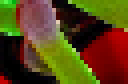
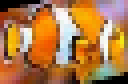
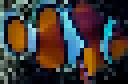
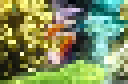
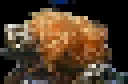
...
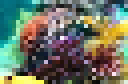
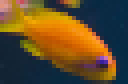
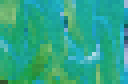
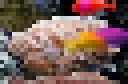
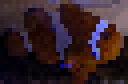

In [229]:
pred = model(test_set[1])
f1(x) = getindex.(argmax(x, dims=1), 1)
pred = f1(pred) .- 1;
size(pred)
(x,y)=test_set
size(y)

p[lt]

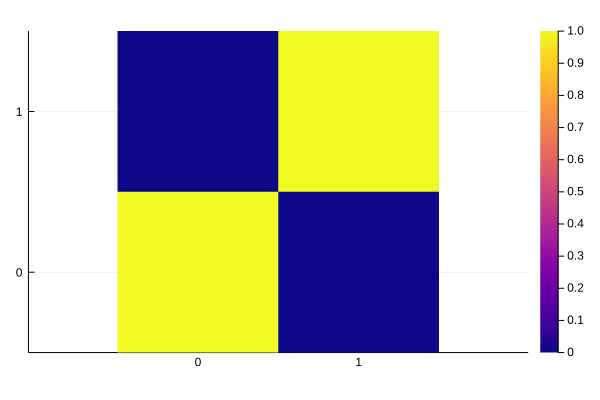

In [230]:
using MLBase # Adding 1 to outcome because the index 0 in arrays does not exist in Julia:
Cm = confusmat(2, rt .+ 1, vec(pred) .+ 1)# Normalize output: 
Cm = Cm ./ sum(Cm, dims=2) # Labels 
xs = [string(i) for i = 0:1] 
heatmap(xs, xs, Cm, aspect_ratio=1, color=:plasma)

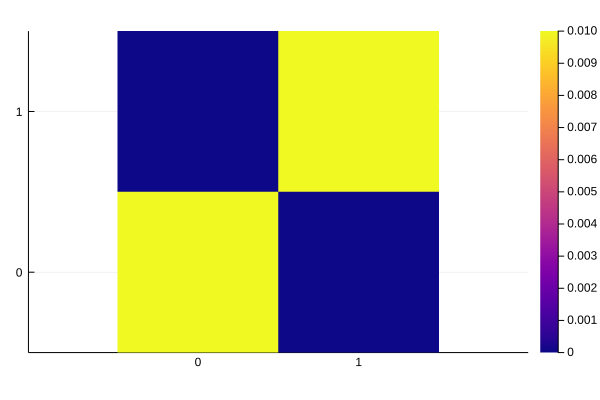

In [231]:
# Limits to colormap, so we can see where errors are located: 
xs = [string(i) for i = 0:1] 
heatmap(xs, xs, Cm, aspect_ratio=1, color=:plasma, clim=(0., 0.01))

In [14]:
esPixelRojo(pixel::RGB, dRV=0.3, dRA=0.3) = (pixel.r > pixel.g + dRV) && (pixel.r > pixel.b + dRA);
esPixelRojo(pixel::RGBA, dRV=0.3, dRA=0.3) = (pixel.r > pixel.g + dRV) && (pixel.r > pixel.b + dRA);

In [15]:
esPixelBlanco(pixel::RGB, dr=0.3, dg=0.3, db=0.3) = (pixel.r + dr >= 1) && (pixel.g + dg >= 1) && (pixel.b + db >= 1);
esPixelBlanco(pixel::RGBA, dr=0.3, dg=0.3, db=0.3) = (pixel.r + dr >= 1) && (pixel.g + dg >= 1) && (pixel.b + db >= 1);

In [16]:
function get_orange_white_boolean(imagen)
    
    diferenciaRojoVerde = 0.3; 
    diferenciaRojoAzul = 0.3;
    
    canalRojo = red.(imagen); 
    canalVerde = green.(imagen); 
    canalAzul = blue.(imagen);
    
    white_chanel = (zeros(size(canalRojo)[1], size(canalRojo)[2]).+0.6);
    white_chanel1 = (zeros(size(canalRojo)[1], size(canalRojo)[2]).+0.9);
    
    mb_w =  (canalRojo.>white_chanel.+ mean(canalRojo)) .& 
            (canalVerde.>white_chanel.- mean(canalVerde)) .& 
            (canalAzul.>white_chanel.- mean(canalAzul));
    
    mb_w1 =  (canalRojo.>white_chanel1) .& 
            (canalVerde.>white_chanel1) .& 
            (canalAzul.>white_chanel1);
    
    mb_r =  (canalRojo.>(canalVerde.+diferenciaRojoVerde)) .& 
            (canalRojo.>(canalAzul.+diferenciaRojoAzul));
    
    matrizBooleana = mb_r .| mb_w1 #.| mb_w1; 
    
    return matrizBooleana;
end;

In [17]:
function check_region(x1, y1, x2, y2, imagen, modelo, h_size, w_size, wall)
    img_v = @view imagen[x1:x2, y1:y2];
    img_v = imresize(img_v, (h_size, w_size));
    img_CHW = permutedims(channelview(img_v),[2,3,1]);
    
    r = Array{Float32}(undef, size(img_CHW)...,1)
    r[:,:,:,1] = img_CHW[:,:,:];
    
    predict = model(r);
    
    if(predict[2] > wall)
        imagen[x1:x2, y1] .= RGB(0,1,0);
        imagen[x1:x2, y2] .= RGB(0,1,0);
        imagen[x1, y1:y2] .= RGB(0,1,0);
        imagen[x2, y1:y2] .= RGB(0,1,0);
    end
    if(predict[1] > wall)
        imagen[x1:x2, y1] .= RGB(1,0,0);
        imagen[x1:x2, y2] .= RGB(1,0,0);
        imagen[x1, y1:y2] .= RGB(1,0,0);
        imagen[x2, y1:y2] .= RGB(1,0,0);
    end
end

check_region (generic function with 1 method)

In [18]:
function process_picture(filePath, modelo, h_size, w_size, wall)
    imagen = load(filePath);
    booleanMatrix = get_orange_white_boolean(imagen);
    booleanMatrix = closing(dilate(booleanMatrix,[1,2]))
    
    labelArray = ImageMorphology.label_components(booleanMatrix);
    boundingBoxes = ImageMorphology.component_boxes(labelArray);
    tamanos = ImageMorphology.component_lengths(labelArray); #Tamaño del grupo 
    pixeles = ImageMorphology.component_indices(labelArray);
    pixeles = ImageMorphology.component_subscripts(labelArray);
    centroides = ImageMorphology.component_centroids(labelArray);

    min_size = (size(imagen)[1]*size(imagen)[2]/600);
    etiquetasEliminar = findall(tamanos .<= min_size) .- 1;
    matrizBooleana = [!in(etiqueta,etiquetasEliminar) && (etiqueta!=0) for etiqueta in labelArray];
    
    labelArray = ImageMorphology.label_components(matrizBooleana);
    imagenObjetos = RGB.(matrizBooleana, matrizBooleana, matrizBooleana);
    centroides = ImageMorphology.component_centroids(labelArray)[2:end];
    
    for centroide in centroides
        x = Int(round(centroide[1]));
        y = Int(round(centroide[2]));
        imagenObjetos[ x, y ] = RGB(1,0,0);
    end;
    
    imagen = load(filePath)
    
    boundingBoxes = ImageMorphology.component_boxes(labelArray)[2:end];
    
    for boundingBox in boundingBoxes
        x1 = boundingBox[1][1];
        y1 = boundingBox[1][2];
        x2 = boundingBox[2][1];
        y2 = boundingBox[2][2];

       check_region(x1,y1,x2,y2, imagen, modelo, h_size, w_size, wall)
    end;
    return imagen;
end;

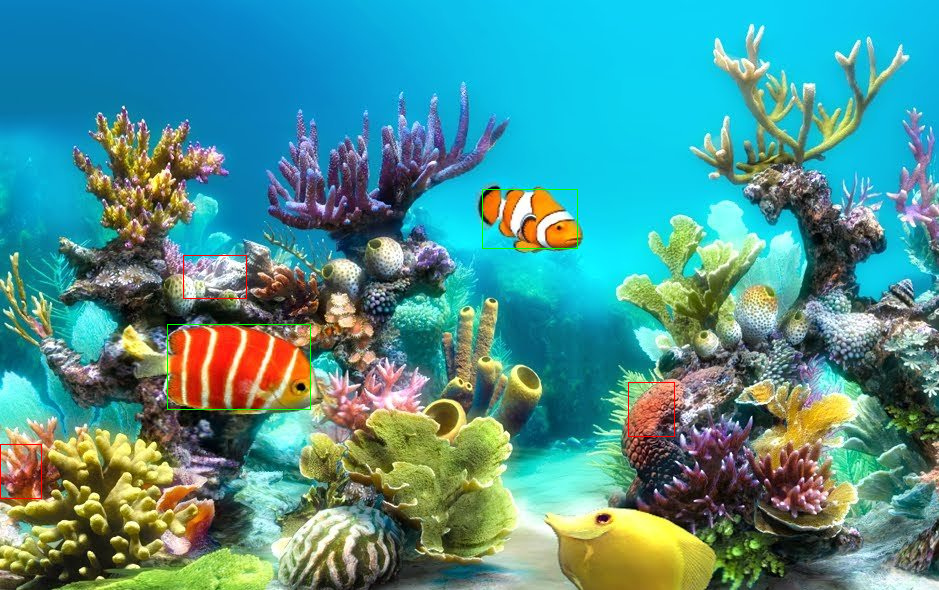

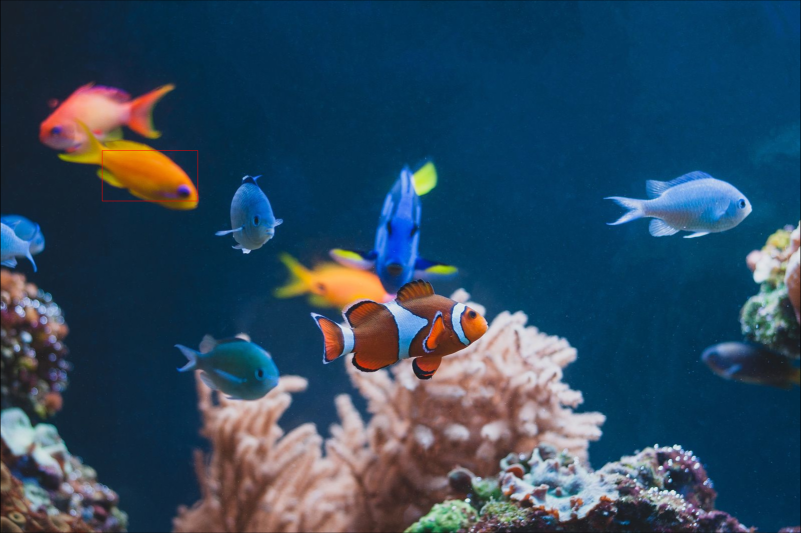

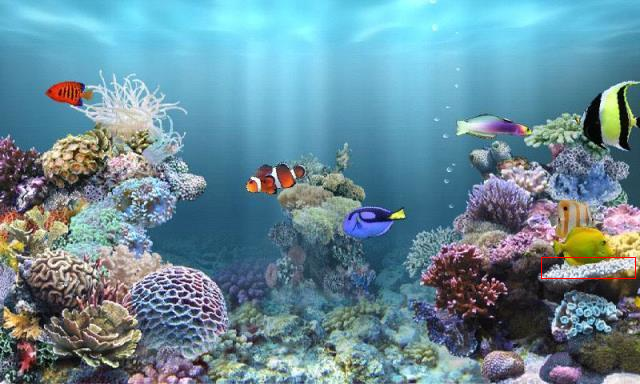

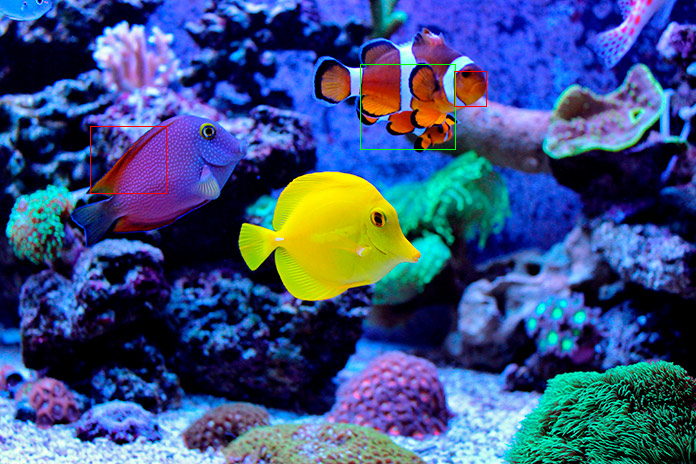

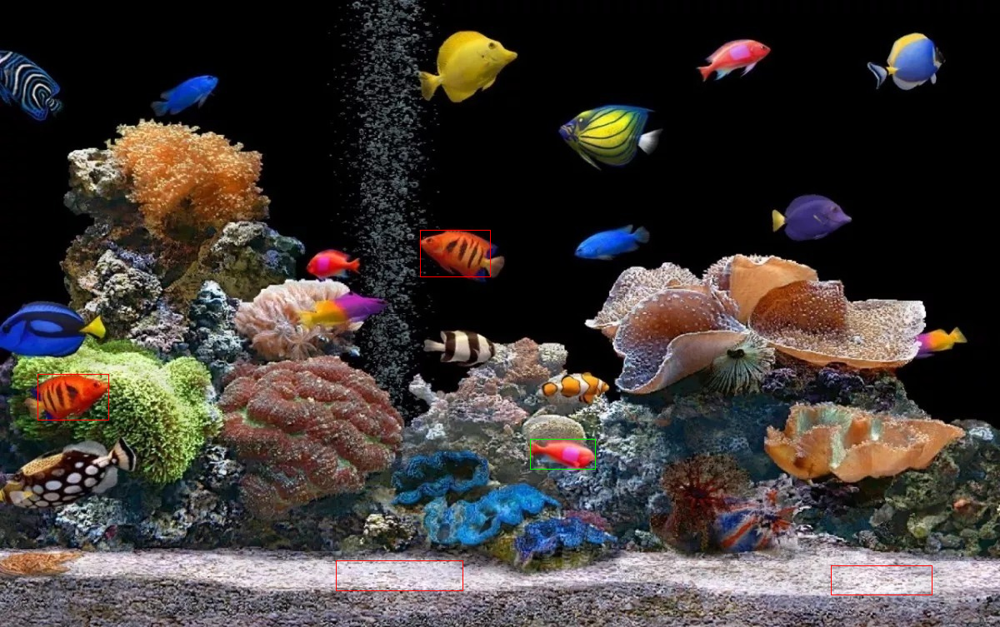

...

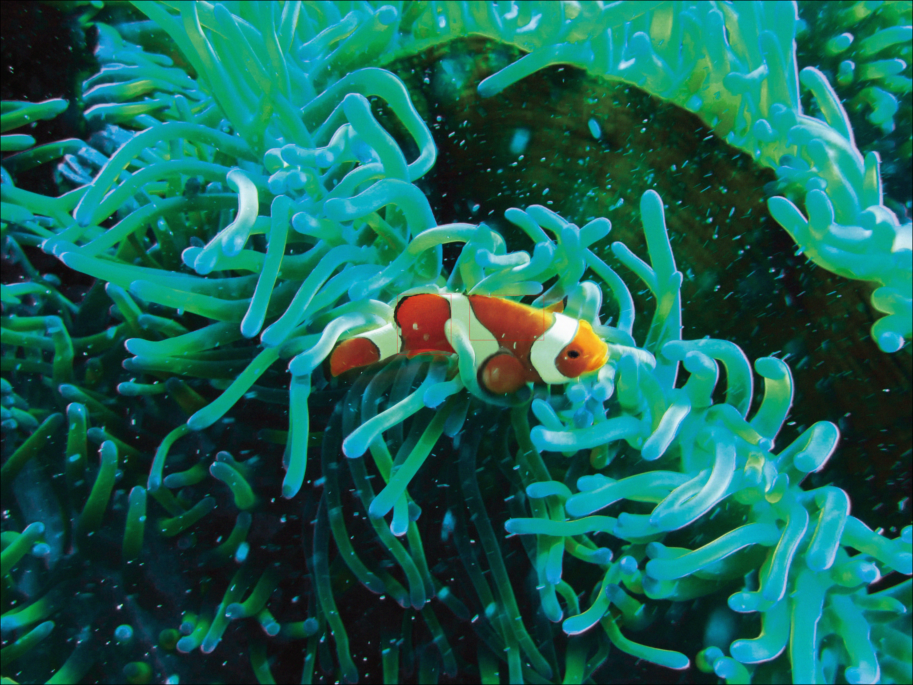

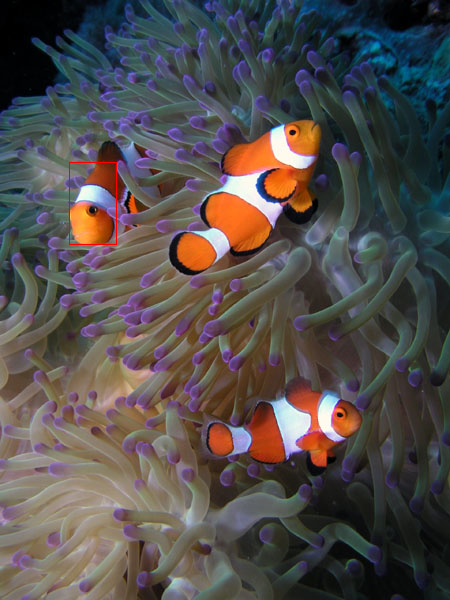

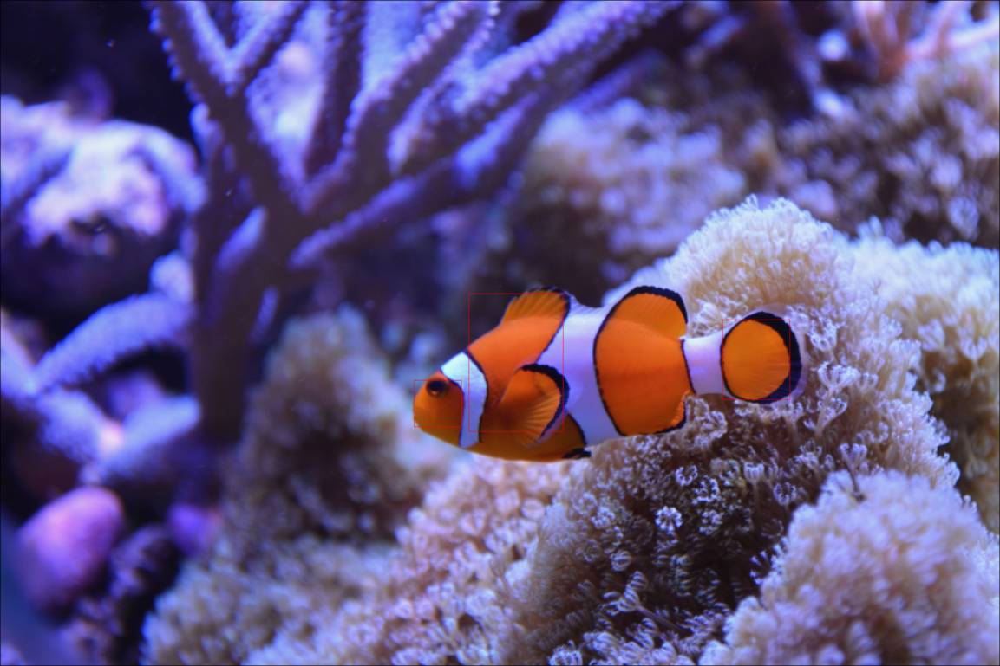

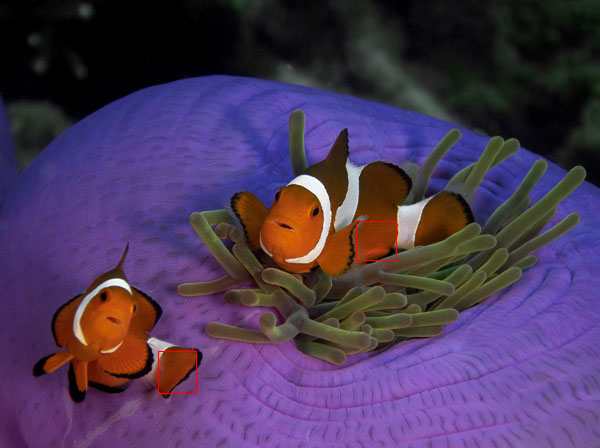

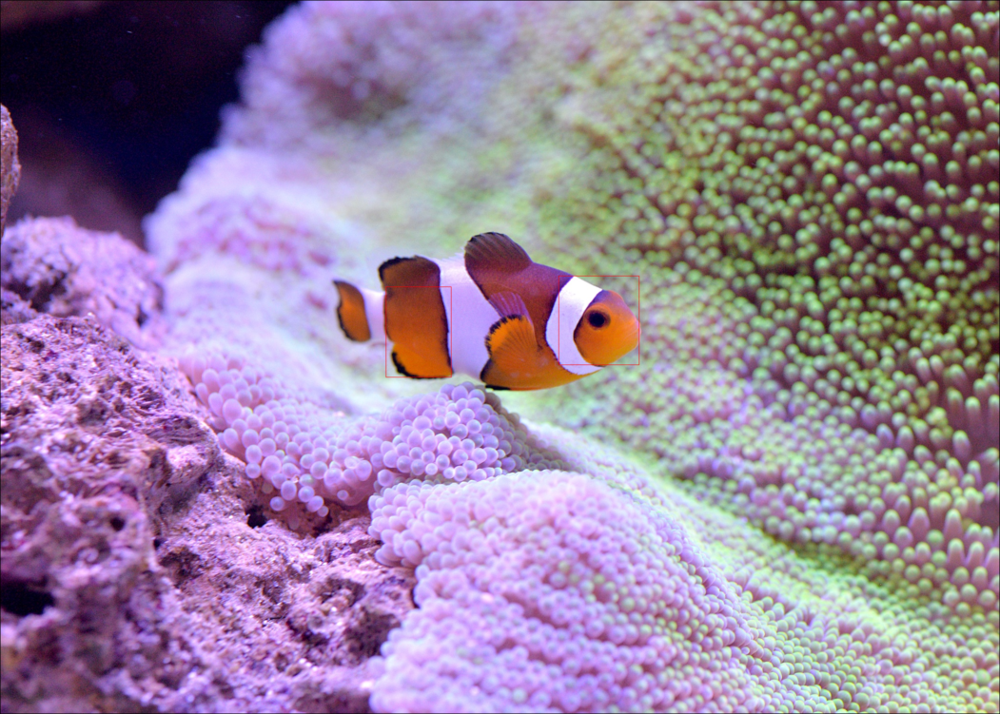

In [232]:
directorio = readdir("../db/fotos");

for file in directorio 
    imagen = process_picture(string("../db/fotos/",file), model, 21, 32, 0.72);
    display(imagen)
end; 

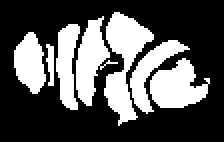

In [20]:
img = load("../db/positivos/p001.jpg")
mbool = esPixelRojo.(img)+esPixelBlanco.(img)
Gray.(mbool)

In [233]:
img_v = imresize(img, (21, 32));
img_CHW = permutedims(channelview(img_v),[2,3,1]);
r = Array{Float32}(undef, size(img_CHW)...,1)
r[:,:,:,1] = img_CHW[:,:,:];
model(r)

2×1 Array{Float32,2}:
 0.9998411    
 0.00015887736

In [234]:
segment_to_image(segments) = map(i->segment_mean(segments, i), labels_map(segments));

In [255]:
img = load("../db/fotos/pez001.jpg");
seg = fast_scanning(img, 0.15)
bw = Gray.(img) .> 0.5;
dist = 1 .- distance_transform(feature_transform(bw));
markers = label_components(dist .< -15);
seg = watershed(dist, markers);
display(segment_to_image(seg))

UndefVarError: UndefVarError: get_random_color not defined

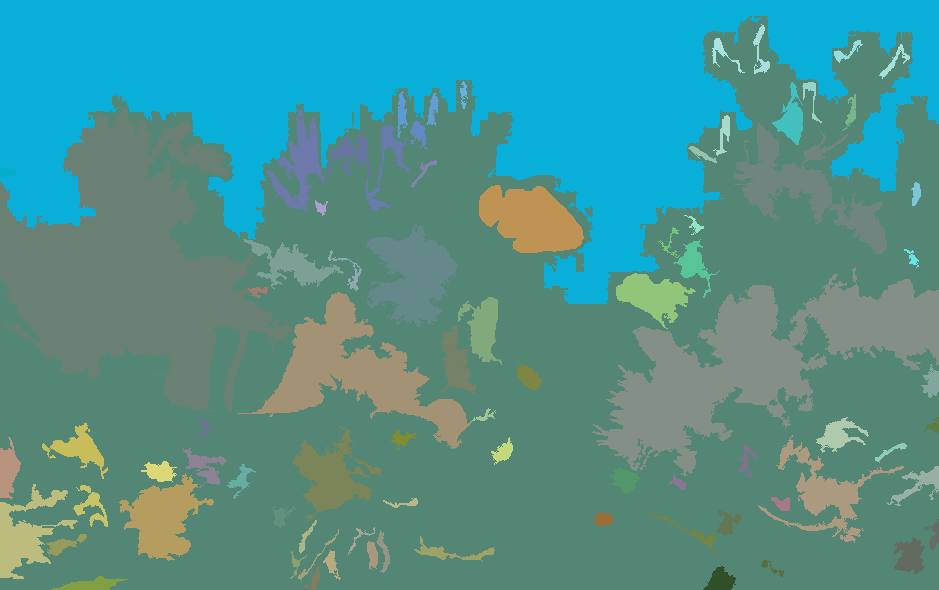

In [256]:
img = load("../db/fotos/pez001.jpg");
seg = felzenszwalb(img, 60, 100)
display(segment_to_image(seg))

764.5

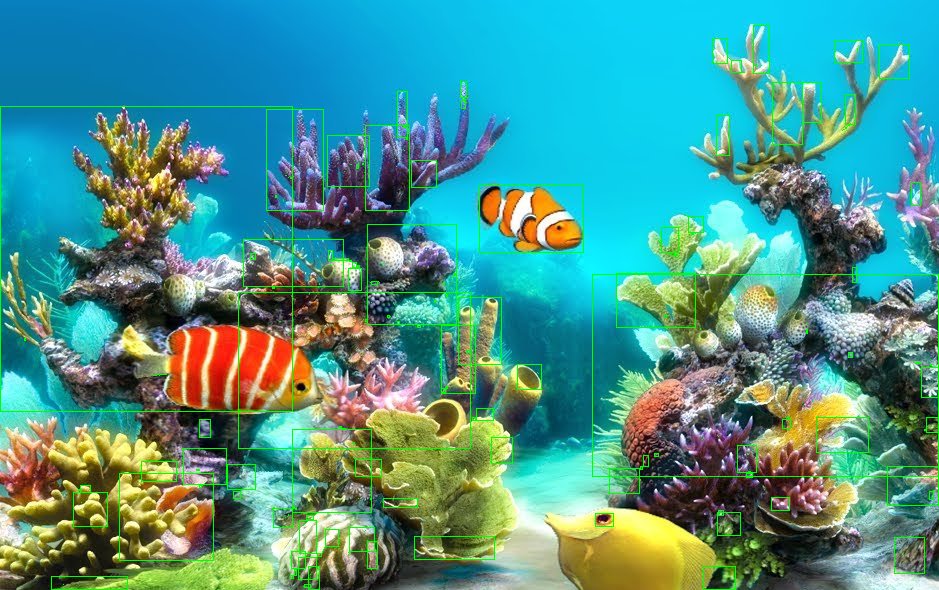

In [258]:
img = load("../db/fotos/pez001.jpg");
img_g = Gray.(img)


#seg = felzenszwalb(img, 10, 100)

labels = labels_map(seg)
boundingBoxes = ImageMorphology.component_boxes(labels)
tamanos = ImageMorphology.component_lengths(labels)

max_size = (size(img,1) + size(img,2 ))/2
min_size = (size(img,1) + size(img,2 ))/3

show(max_size)
#etiquetasEliminar =  findall(tamanos .<= min_size .+ tamanos .>= max_size) .- 1;

etiquetasEliminar1 = findall(tamanos .<= min_size ) .- 1;
etiquetasEliminar2 = findall(tamanos .>= max_size) .- 1;


#matrizBooleana = [!in(etiqueta,etiquetasEliminar1) && !in(etiqueta,etiquetasEliminar2) && (etiqueta!=0) for etiqueta in labels];
matrizBooleana = [!in(etiqueta,etiquetasEliminar) && (etiqueta!=0) for etiqueta in labels];

labelArray = ImageMorphology.label_components(matrizBooleana);
imagenObjetos = RGB.(matrizBooleana, matrizBooleana, matrizBooleana);
centroides = ImageMorphology.component_centroids(labelArray)[2:end];
boundingBoxes = ImageMorphology.component_boxes(labelArray)[2:end];

for boundingBox in boundingBoxes
    x1 = boundingBox[1][1];
    y1 = boundingBox[1][2];
    x2 = boundingBox[2][1];
    y2 = boundingBox[2][2];

    img[x1:x2, y1] .= RGB(0,1,0);
    img[x1:x2, y2] .= RGB(0,1,0);
    img[x1, y1:y2] .= RGB(0,1,0);
    img[x2, y1:y2] .= RGB(0,1,0);
end;
        
img